In [ ]:
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
!bunzip2 shape_predictor_68_face_landmarks.dat.bz2

--2025-06-26 16:26:15--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2 [following]
--2025-06-26 16:26:15--  https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Connecting to dlib.net (dlib.net)|107.180.26.78|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M  38.9MB/s    in 1.6s    

2025-06-26 16:26:17 (38.9 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]

bunzip2: Output file shape_predictor_68_face_landmarks.dat already exists.


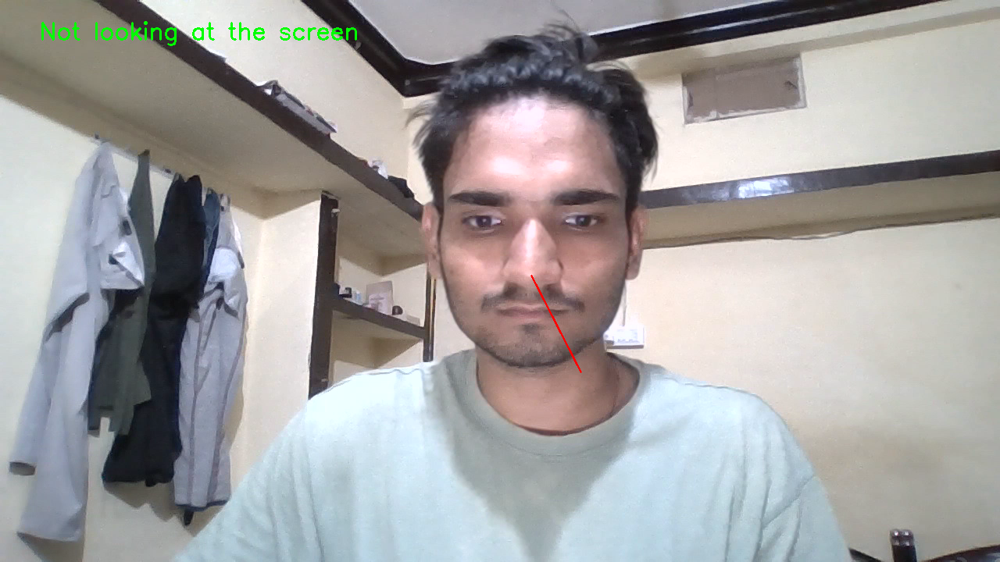

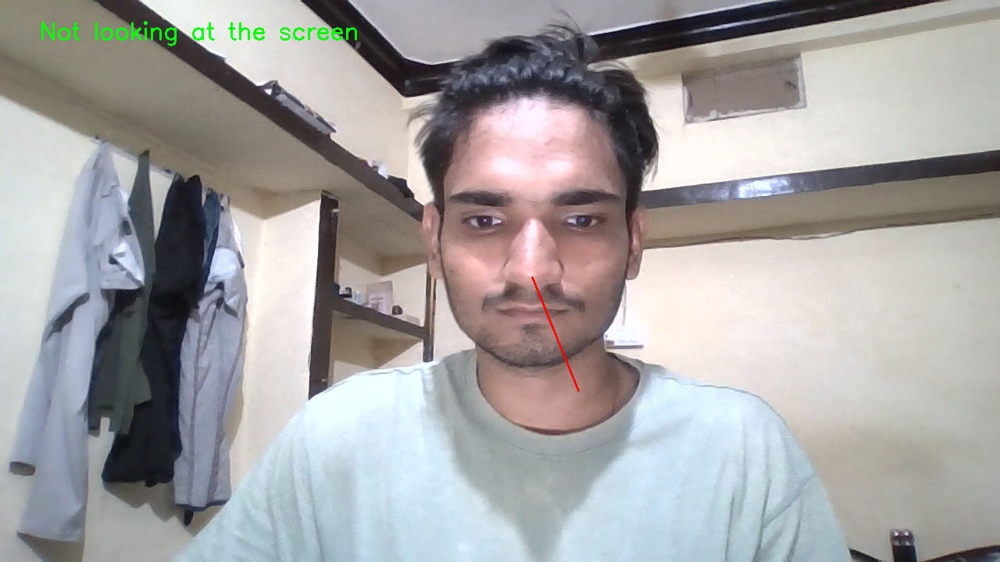

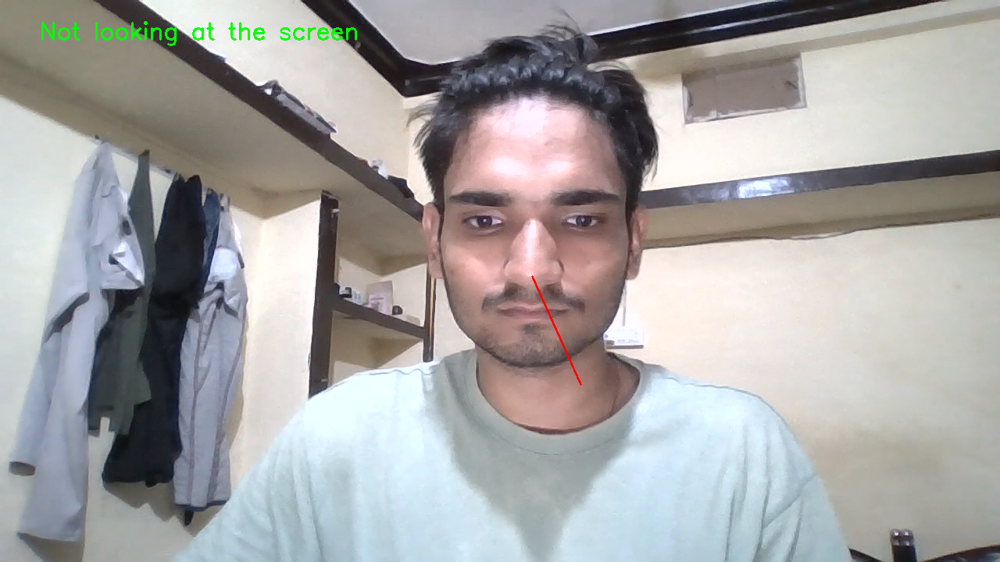

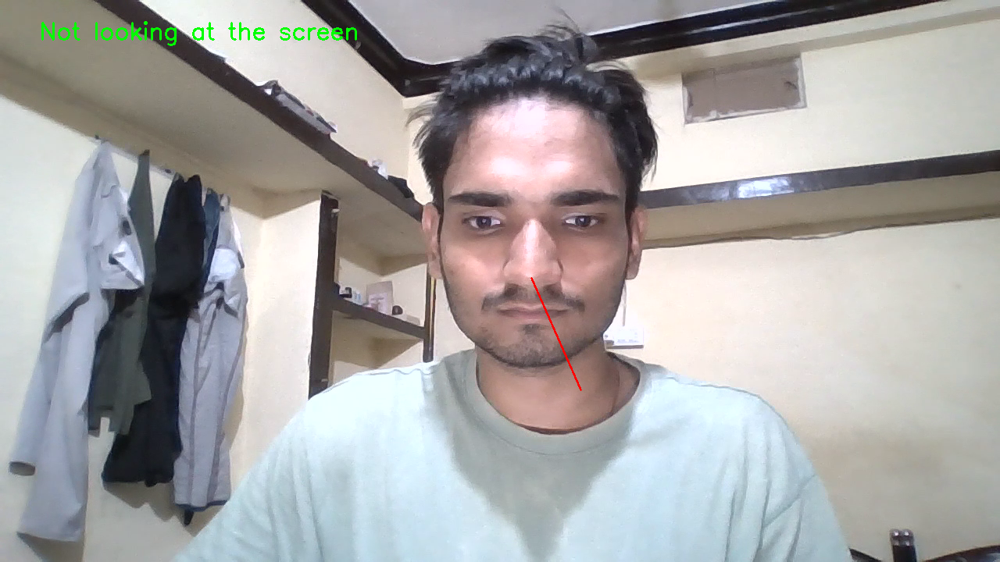

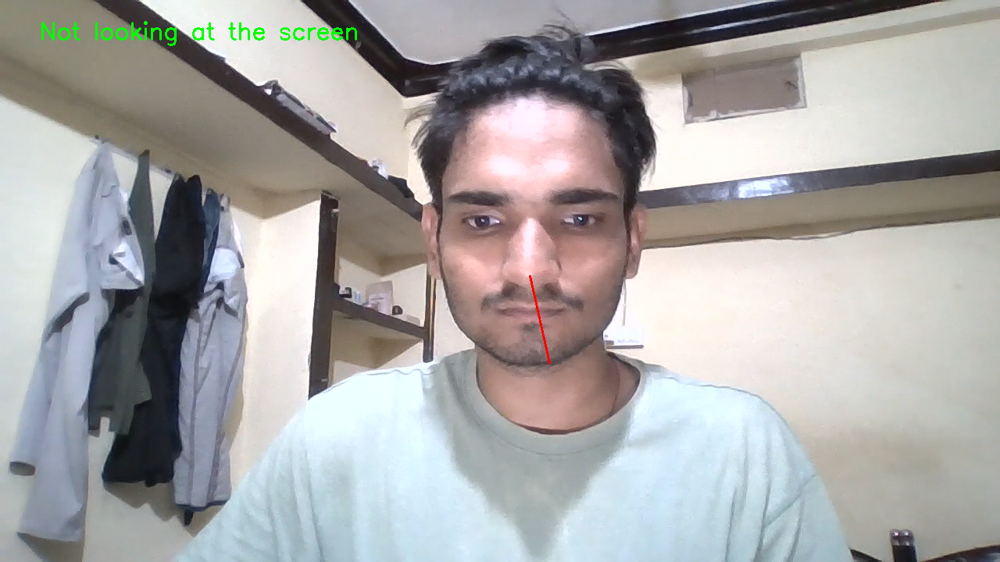

...

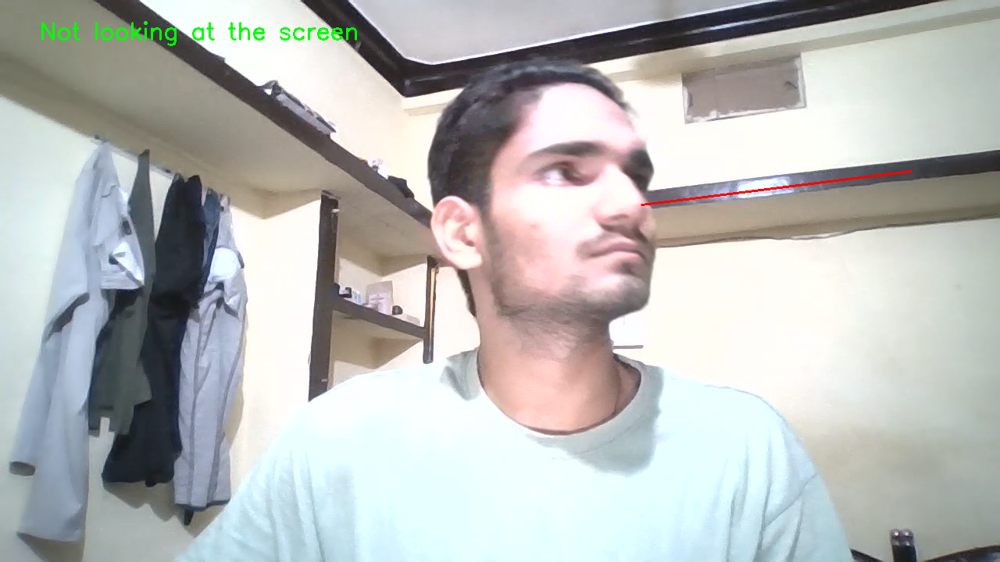

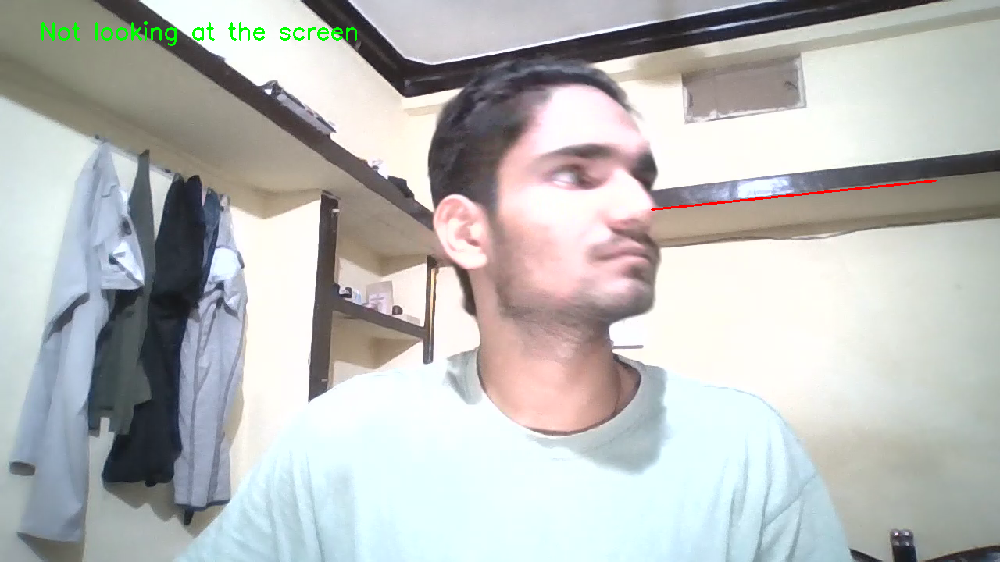

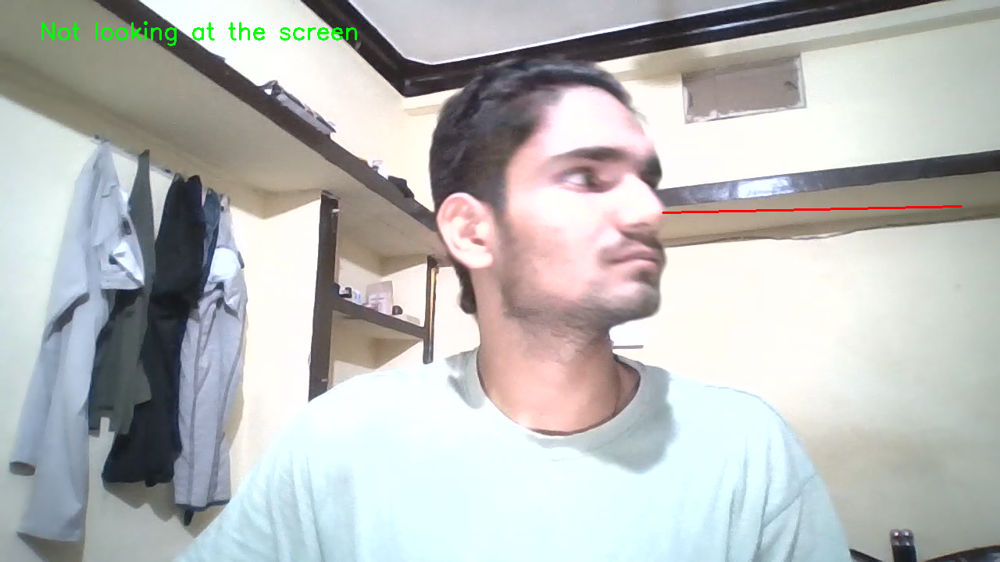

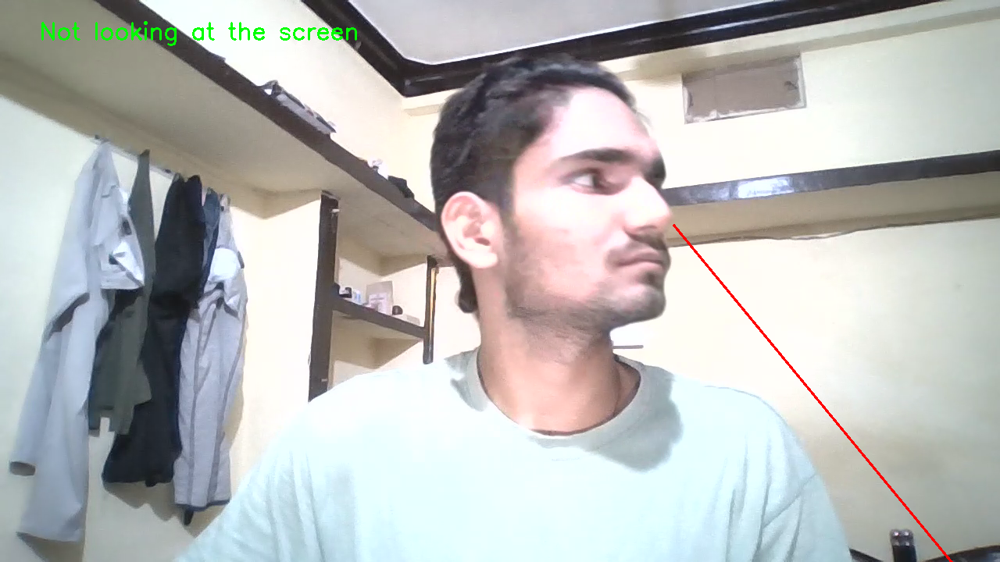

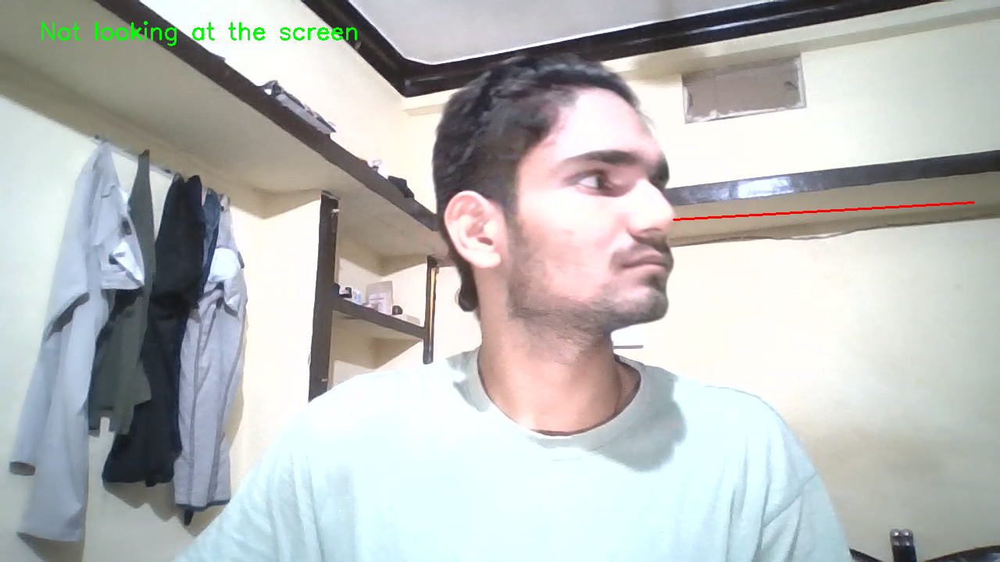

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import dlib
import numpy as np
from imutils import face_utils
from google.colab.patches import cv2_imshow

# Initialize dlib's face detector and shape predictor
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")

# Define 3D model points of the face (these are fixed relative to the face)
model_points = np.array([
    (0.0, 0.0, 0.0),  # Nose tip
    (0.0, -330.0, -65.0),  # Chin
    (-225.0, 170.0, -135.0),  # Left eye left corner
    (225.0, 170.0, -135.0),  # Right eye right corner
    (-150.0, -150.0, -125.0),  # Left mouth corner
    (150.0, -150.0, -125.0)  # Right mouth corner
])

# Define the camera matrix (intrinsic camera parameters)
# You may need to adjust these based on your camera
focal_length = 1.0 * 640  # Assuming the focal length is approximately the width of the frame
center = (320, 240)  # Assuming the center of the image
camera_matrix = np.array([[focal_length, 0, center[0]],
                          [0, focal_length, center[1]],
                          [0, 0, 1]], dtype="double") # Fixed the unmatched parenthesis

# Distortion coefficients - assuming no lens distortion
dist_coeffs = np.zeros((4, 1))

# Start video capture
cap = cv2.VideoCapture('/content/video.mp4')

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Convert to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Detect faces in the grayscale image
    faces = detector(gray)

    for face in faces:
        # Get facial landmarks
        landmarks = predictor(gray, face)
        landmarks = face_utils.shape_to_np(landmarks)

        # Get the 2D image points (corresponding to the model points)
        image_points = np.array([
            (landmarks[30][0], landmarks[30][1]),  # Nose tip
            (landmarks[8][0], landmarks[8][1]),  # Chin
            (landmarks[36][0], landmarks[36][1]),  # Left eye left corner
            (landmarks[45][0], landmarks[45][1]),  # Right eye right corner
            (landmarks[48][0], landmarks[48][1]),  # Left mouth corner
            (landmarks[54][0], landmarks[54][1])  # Right mouth corner
        ], dtype="double")

        # Solve the PnP problem (Perspective-n-Point)
        _, rotation_vector, translation_vector = cv2.solvePnP(model_points, image_points, camera_matrix, dist_coeffs)

        # Project 3D points to a 2D image plane to visualize the result
        (nose_end_point2D, _) = cv2.projectPoints(np.array([(0.0, 0.0, 1000.0)]), rotation_vector, translation_vector, camera_matrix, dist_coeffs)
        p1 = (int(landmarks[30][0]), int(landmarks[30][1]))  # Nose tip
        p2 = (int(nose_end_point2D[0][0][0]), int(nose_end_point2D[0][0][1]))  # Nose end point

        # Draw the line representing the nose direction
        cv2.line(frame, p1, p2, (0, 0, 255), 2)

        # Calculate the angle of the head
        rotation_matrix, _ = cv2.Rodrigues(rotation_vector)
        angle = np.arctan2(rotation_matrix[1, 0], rotation_matrix[0, 0]) * 180.0 / np.pi

        # Check if the angle indicates the person is looking at the screen
        if -10 < angle < 10:
            gaze_status = "Looking at the screen"
        else:
            gaze_status = "Not looking at the screen"

        cv2.putText(frame, gaze_status, (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Display the output frame
    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()